In [1]:
import pandas as pd
import scanpy as sc 
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import rcParams
import os,re


In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings('ignore', 'No data for colormapping provided via', UserWarning)

In [3]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300

In [4]:
os.chdir("/home/maolp/data5/Gaofeng_All_matrix/Allcount/")

In [5]:
plt.style.use('default')
plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.dpi'] = 300

In [6]:
adata1=sc.read_h5ad('All_scanpyData/Data/Scanpy_merge_rmdoubulet_UMAP_label_lastCell.h5ad')

### Function

In [7]:
colorname2=["#46A040" ,"#00AF99", "#FFC179" ,"#98D9E9" ,"#F6313E", "#FFA300", "#333366", "#FF5A00", "#663366","#FF6666",
"#8F1336", "#0081C9", "#001588", "#CC0033","#CC9966","#CC0033","#999933","#009966","#CCCC33","#CCFF99","#333399","#993333",
"#490C65", "#BA7FD0","#A6CEE3", "#1F78B4", "#DE77AE", "#B2DF8A", "#006D2C", "#868686", "#B5AD64","#9DA8E2","#91C392","#FF9900","#339966"]

In [8]:
def create_palette(cell_types, colors):
    cell_type_colors = {}
    for i, cell_type in enumerate(cell_types):
        color = colors[i % len(colors)]
        cell_type_colors[cell_type] = color
    return cell_type_colors

In [9]:
def cluster_small_multiples(
    adata, clust_key, size=60, frameon=False, legend_loc=None, **kwargs
):
    tmp = adata.copy()

    for i, clust in enumerate(adata.obs[clust_key].cat.categories):
        tmp.obs[clust] = adata.obs[clust_key].isin([clust]).astype("category")
        tmp.uns[clust + "_colors"] = ["#d3d3d3", adata.uns[clust_key + "_colors"][i]]

    sc.pl.umap(
        tmp,
        groups=tmp.obs[clust].cat.categories[1:].values,
        color=adata.obs[clust_key].cat.categories.tolist(),
        size=size,
        frameon=frameon,
        legend_loc=legend_loc,
        **kwargs,
    )

In [10]:
# adata1.raw.to_adata()

In [11]:
def Multi_create_sub(adata, cell_type_list, res=1,name='combined_leiden'):
    subgroup = adata[adata.obs['leiden'].isin(cell_type_list)].copy()
    # 预处理亚群
    sc.pp.normalize_total(subgroup)
    sc.pp.log1p(subgroup)
    subgroup.raw = subgroup
    sc.pp.highly_variable_genes(subgroup)
    subgroup = subgroup[:, subgroup.var['highly_variable']]
    sc.pp.scale(subgroup, max_value=10)
    sc.tl.pca(subgroup, svd_solver='arpack')
    sc.pp.neighbors(subgroup)
    sc.tl.leiden(subgroup, resolution=res, key_added=name)
    sc.tl.umap(subgroup)
    sc.pl.umap(subgroup, color=name)
    return subgroup

# # 示例用法
# cell_type_list = ['0', '4', '8']
# combined_subgroup = Multi_create_sub(adata, cell_type_list)


In [12]:
def Multi_organ_sub(adata, cell_type_list,Otypes, res=1,name='combined_leiden'):
    subgroup = adata[adata.obs[Otypes].isin(cell_type_list)].copy()
    sc.pp.normalize_total(subgroup)
    sc.pp.log1p(subgroup)
    subgroup.raw = subgroup
    sc.pp.highly_variable_genes(subgroup)
    subgroup = subgroup[:, subgroup.var['highly_variable']]
    sc.pp.scale(subgroup, max_value=10)
    sc.tl.pca(subgroup, svd_solver='arpack')
    sc.pp.neighbors(subgroup)
    sc.tl.leiden(subgroup, resolution=res, key_added=name)
    sc.tl.umap(subgroup)
    sc.pl.umap(subgroup, color=name)
    return subgroup



### Marker

In [13]:
MEGA_ER_markers = {"Megakaryocyte Erythroid Precursors":['TESPA1','GATA2','FCER1A'],
"Early_ERY":['KLF1','APOE','FAM178B'],
"Mid_ERY":[ 'BLVRB', 'CD36', 'OAT',],
"Late_ERY":[ 'GYPA', 'GYPB', 'SLC4A1'],
"YS_ERY" : ['HBZ','HBE1'],
"Early_MK":['HBD','PF4'],
"late_MK":['ITGA2B','ITGB3','CLK1'],
'MACROPHAGE_ERY':["C1QA","CD163"],
"Proliferating" : ["TOP2A","MKI67"],
          }


In [14]:
 progenitor_gene={'HSC_MPP':['CLEC9A','HLF','CD34','SPINK2'],
           'MLP':['BCL11A','IL7R','IL2RG'],
           'B lineage':['CD19','VPREB1','PAX5'],
           'T lineage':['CD3D','BCL11B'],
           'MEMP':['GATA2'],
           'MEP':['KLF1','ITGA2B'],
           'Ery lineage':['HBB','HBG1'],
           'Myeloid lineage':['MPO','CSF1R','CEBPA'],
                  'Cycling':['MKI67']
          }
# sc.pl.dotplot(sub23,progenitor_gene, '23')

In [15]:
Tcell_markers = {'DN(early)':['IGLL1','ST18'],
           'DN(P)':['TRGC2','TRDC','HIVEP3'],
           'DN(Q)':['RAG1','RAG2','TP53INP1','PTCRA','RGPD3'],
           'DP(P)':['SMPD3'], 
           'DP(Q)':['AQP3','RORC'], 
           'abT(entry)':['CCR9','SATB1','TOX2'], 
           'MATURE_T':['CCR7','CD5','CD27','CD8A','CD8B','CD4'], 
           #'agonist selection':['TNFRSF9','CD27','IKZF2','IKZF3'],
           'Treg':['FOXP3','CTLA4'], 
           'CD8aa':['PDCD1','GNG4','ZNF683'], 
           'innate':['KLRB1','ZBTB16'],
           'TYPE_3_INNATE_T':['CD40LG','RORC','CCR6','ANXA1'],
           'ILC3': ['RORC','IL1R1','IL23R','KIT'],
           'ILC2':['PTGDR2','HPGDS','GATA3'],
           'TYPE_1_INNATE_T':['NKG7','EOMES','TBX21','IFNG-AS1'],
           'NK': ['KLRD1','KLRF1','NKG7','NCAM1'],
        
           'CYCLING':['MKI67'],
          }


In [16]:
Bcell_markers = {
    "Lymphoid Progenitor": ["CD34", "SPINK2", "IL7R", "KIT"],
    "PRE_PRO_B": ["FLT3", "CD19", "VPREB1"],
    "PRO_B": ["MME", "CDC45", "DHFR", "MKI67"],
    "LATE PRO B": ["CD27", "RAG1", "DNTT", "VPREB3"],
    "PRO_PRE": ["CD24", "TNFRSF17"],
    "PRE_IMMATURE": ["MME", "IDH2", "SPIB", "IL4R", "IGHM"],
    "MATURE": ["IGHD", "MS4A1", "CD40", "FCER2"],
    "B1": ["CD27", "SPN", "CCR10"],
    "PLASMA B": ["JCHAIN", "SDC1", "CD38"],
    "IGKC":["IGKC"],
    "CYCLING B": ["MKI67"]
}
# https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7612819/#SD10 ## 附属文件pdf

In [17]:
Bcell_type_genes = {
    "HSC_MPP": ["CLEC9A", "CD34", "SPINK2", "KIT", "FLT3"],
    "CMP": ["CD34", "SPINK2", "MPO", "CSF1R", "KIT", "FLT3"],
    "ELP": ["CD34", "SPINK2", "IL7R", "KIT", "FLT3"],
    "PRE PRO B CELL": ["FLT3", "CD19", "VPREB1", "RAG1", "MS4A1"],
    "PRO B CELL": ["CD19", "VPREB1", "MME", "CDC45", "DHFR", "MKI67", "RAG1", "DNTT", "CD24", "MME", "IDH2"],
    "LATE PRO B CELL": ["CD19", "VPREB1", "MME", "DHFR", "MKI67", "RAG1", "DNTT", "CD24", "MME"],
    "PRO TO PRE B CELL": ["CD19", "VPREB1", "MME", "CDC45", "DHFR", "MKI67", "MS4A1", "CD24", "MME", "IDH2"],
    "LARGE PRE B CELL": ["CD19", "VPREB1", "MME", "CDC45", "DHFR", "MKI67", "RAG1", "CD24", "TNFRSF17", "MME"],
    "SMALL PRE B CELL": ["CD19", "VPREB1", "RAG1", "CD24", "TNFRSF17", "MME"],
    "IMMATURE B CELL": ["CD19", "MS4A1", "CD24", "SPIB", "CD40", "FCER2"],
    "MATURE B CELL": ["CD19", "MS4A1", "CD24", "CD40", "FCER2"],
    "CYCLING B/B1 CELL": ["CD19", "MKI67", "CD27", "MS4A1", "CD24", "CD5", "SPN", "CD40", "FCER2"],
    "PLASMA B CELL": ["CD19", "CD27", "MS4A1", "CD24", "TNFRSF17", "CD40", "FCER2", "JCHAIN", "SDC1", "CD38"]
}
#     26: 'Monocytes-MK like',
#     27: 'Monocytes-CD177',
#     28: 'Monocytes-NKG7',
#     29: 'CD56highCD16-',

In [18]:
Bcell_type_genes = {
    "HSC_MPP": ["CLEC9A", "CD34", "SPINK2", "KIT", "FLT3"],
    "PRE PRO B CELL": ["FLT3", "CD19", "VPREB1", "RAG1", "MS4A1"],
    "PRO B CELL": ["CD19", "VPREB1", "MME", "CDC45", "DHFR", "MKI67", "RAG1", "DNTT", "CD24", "MME", "IDH2"],
    "LATE PRO B CELL": ["CD19", "VPREB1", "MME", "DHFR", "MKI67", "RAG1", "DNTT", "CD24", "MME"],
    "PRO TO PRE B CELL": ["CD19", "VPREB1", "MME", "CDC45", "DHFR", "MKI67", "MS4A1", "CD24", "MME", "IDH2"],
    "LARGE PRE B CELL": ["CD19", "VPREB1", "MME", "CDC45", "DHFR", "MKI67", "RAG1", "CD24", "TNFRSF17", "MME"],
    "SMALL PRE B CELL": ["CD19", "VPREB1", "RAG1", "CD24", "TNFRSF17", "MME"],
    "IMMATURE B CELL": ["CD19", "MS4A1", "CD24", "SPIB", "CD40", "FCER2"],
    "MATURE B CELL": ["CD19", "MS4A1", "CD24", "CD40", "FCER2"],
    "CYCLING B/B1 CELL": ["CD19", "MKI67", "CD27", "MS4A1", "CD24", "CD5", "SPN", "CD40", "FCER2"],
    "PLASMA B CELL": ["CD19", "CD27", "MS4A1", "CD24", "TNFRSF17", "CD40", "FCER2", "JCHAIN", "SDC1", "CD38"]
}
#     26: 'Monocytes-MK like',
#     27: 'Monocytes-CD177',
#     28: 'Monocytes-NKG7',
#     29: 'CD56highCD16-',

In [19]:
Myeloid_markers={'Early Progenitor': ['CD34', 'SPINK2', 'MLLT3'],
 'Myeloid_progenitor': ['PRSS57', 'PRTN3', 'AZU1'],
 'Neutrophil lineage': ['ELANE', 'DEFA4', 'LCN2', 'LTF', 'ORM1'],
 'Monocyte_lineage': ['CD52', 'S100A8', 'MS4A6A','CD14', 'CXCR4', 'CCR2', 'IL1B', 'CD300E'],
 'DC progenitor': ['ACY3', 'TIFAB', 'KIF17'],
 'pDC': ['CLEC4C', 'JCHAIN', 'IRF7'],
 'DC1': ['CLEC9A', 'BATF3'],
 'MIGRATORY DC': ['CCR7', 'LAMP3'],
 'MAST': ['CLC', 'KIT', 'TPSAB1'],
 'Monocytes-MK like': ['HBD','PF4'],
 'Monocytes-CD177': ['CD177'],
 'Monocytes-NKG7': ['NKG7'],
}

In [20]:
MEGA_ER_markers = {"Megakaryocyte Erythroid Precursors":['TESPA1','GATA2','FCER1A'],
"Early_ERY":['KLF1','APOE','FAM178B'],
"Mid_ERY":[ 'BLVRB', 'CD36', 'OAT',],
"Late_ERY":[ 'GYPA', 'GYPB', 'SLC4A1'],
"YS_ERY" : ['HBZ','HBE1'],
"Early_MK":['HBD','PF4'],
"late_MK":['ITGA2B','ITGB3','CLK1'],
'MACROPHAGE_ERY':["C1QA","CD163"],
"Proliferating" : ["TOP2A","MKI67"],
          }


In [21]:
EMpgene={'Early Progenitor': ['CD34', 'SPINK2', 'MLLT3'],
 'Myeloid_progenitor': ['PRSS57', 'PRTN3', 'AZU1'],
 'Neutrophil lineage': ['ELANE', 'DEFA4', 'LCN2', 'LTF', 'ORM1'],
 'Monocyte_lineage': ['CD52',
  'S100A8',
  'MS4A6A',
  'CD14',
  'CXCR4',
  'CCR2',
  'IL1B',
  'CD300E','FCGR3A'],
 'DC progenitor': ['ACY3', 'TIFAB', 'KIF17'],
 'pDC': ['CLEC4C', 'JCHAIN', 'IRF7'],
 'DC2': ['CLEC10A', 'CD1C'],
 'DC1': ['CLEC9A', 'BATF3'],
 'MIGRATORY DC': ['CCR7', 'LAMP3'],
 'LANGERHANS CELLS': ['IDO1', 'CD207', 'CD1A'],
 'EO BASO MAST': ['CLC', 'KIT', 'TPSAB1'],
 'MAC LYVE1 HIGH': ['F13A1', 'LYVE1', 'SPP1'],
 'MAC IRON RECYCLING': ['CD5L', 'APOE', 'VCAM1'],
 'MAC PROLIFERATING': ['TOP2A', 'MKI67'],
 'MAC MHCII HIGH': ['HLA-DRA', 'HLA-DPA1', 'CLEC7A'],
 'MAC KUPFFER LIKE': ['ENG', 'KDR', 'CAV1'],
 'MAC TREM2': ['TREM2', 'P2RY12'],
 'MAC TLF+': ['TIMD4', 'FOLR2', 'LYVE1'],
 'OSTEOCLAST': ['MMP9', 'ACP5']}

In [22]:
livermarker=['HLA-DRA', 'CD34', 'SPINK2', 'JCHAIN', 'IGLL1', 
             'CD79B', 'TCL1A', 'IGKC', 'MS4A1', 'CD19', 'LTB',
             'KLRB1', 'PTPRC','CD3E','CD7', 'IL32', 'CD8A', 'KLRD1', 
             'NKG7', 'XCL2', 'NCAM1', 'MPO', 'LYZ', 'PLAC8', 'IL3RA', 
             'CLEC9A', 'CD1C', 'S100A9', 'CCL4', 'CD14', 'FCGR3A', 'CD4',
             'C1QA', 'VCAM1', 'GYPA', 'SERPINB1', 'TPSAB1', 'KIT', 'PF4',
             'ITGA2B', 'GATA1', 'KLF1', 'ALAS2', 'HBA1', 'BPGM', 'ESAM', 'ECM1', 'APOA1']


# https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6861135/


In [23]:
BALLgen=['CD3D','CD3G','CD3E','CD4', 'CD8A', 'SELL', 'TCF7', 'CCR7', 'LEF1', 'NKG7',
     'GNLY', 'PRF1', 'TRDC', 'TRDV2','TRGC1','TRGC2','TRGV9','ITGAE','KLRC1', 
     'GZMK', 'GZMH', 'NCR3', 'LAG3', 'PDCD1', 'TRAV1-2', 'FOXP3']

# https://onlinelibrary.wiley.com/cms/asset/a65a26eb-e135-4abb-8e6a-0d487e16e1d8/advs2932-fig-0001-m.jpg

### Annotation

In [24]:

t_cells = adata1[adata1.obs["Last_cell_type"].str.contains("T", case=True), :]


ilc_cells = adata1[adata1.obs["Last_cell_type"].str.contains("ILC"), :]

NK_cells = adata1[adata1.obs["Last_cell_type"].str.contains(" NK"), :]

NKILCcells=t_cells.concatenate(ilc_cells)


Tcombined_cells = t_cells.concatenate(ilc_cells)

TNKcombined_cells =Tcombined_cells.concatenate(NK_cells)
TNKILCcombined_cells=TNKcombined_cells

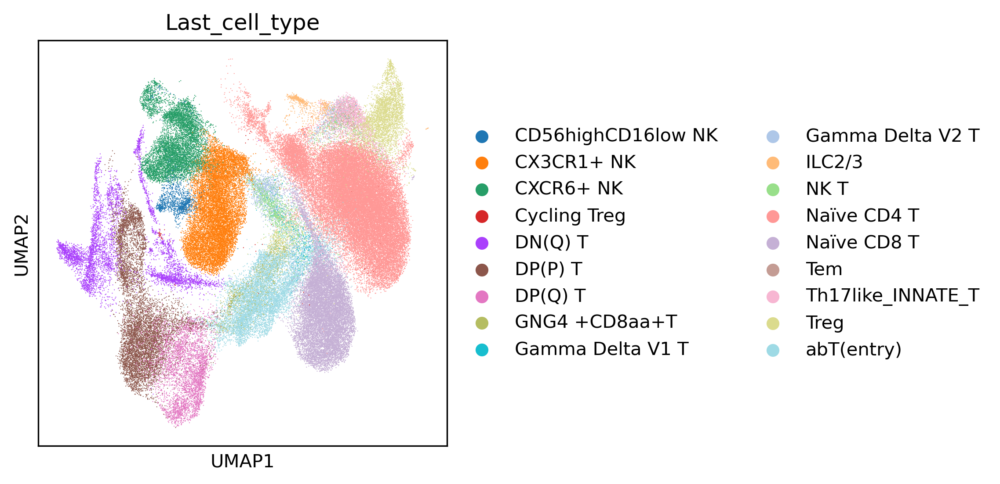

In [25]:
sc.pl.umap(TNKILCcombined_cells,color=['Last_cell_type'])

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


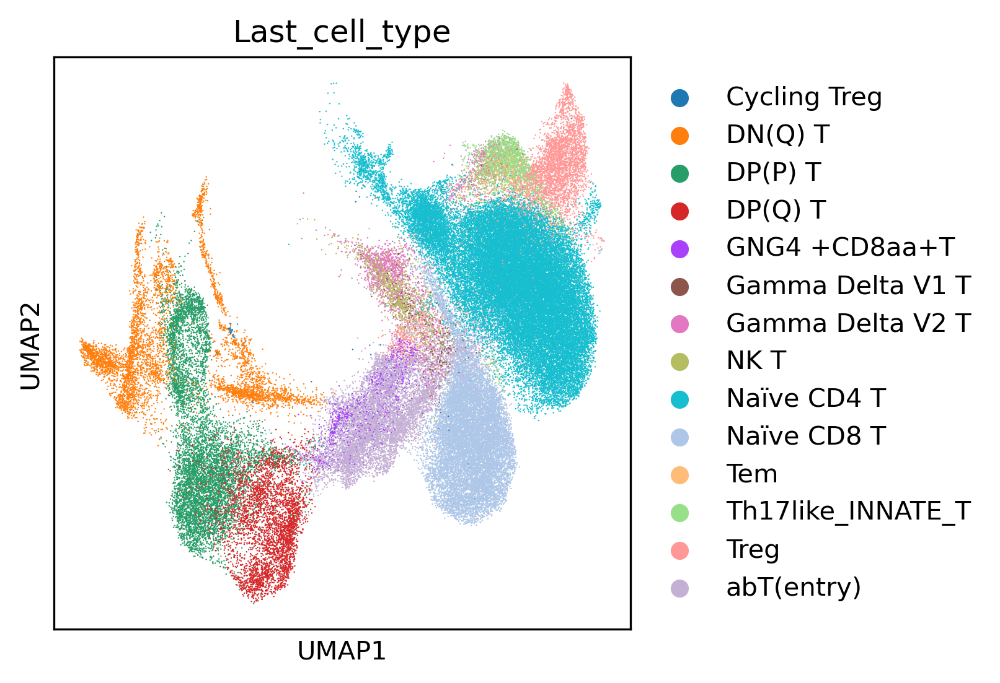

In [26]:
sc.pl.umap(t_cells,color=['Last_cell_type'])

In [27]:
thymust_cell=t_cells[t_cells.obs.New_Body.isin(['Thymus'])]

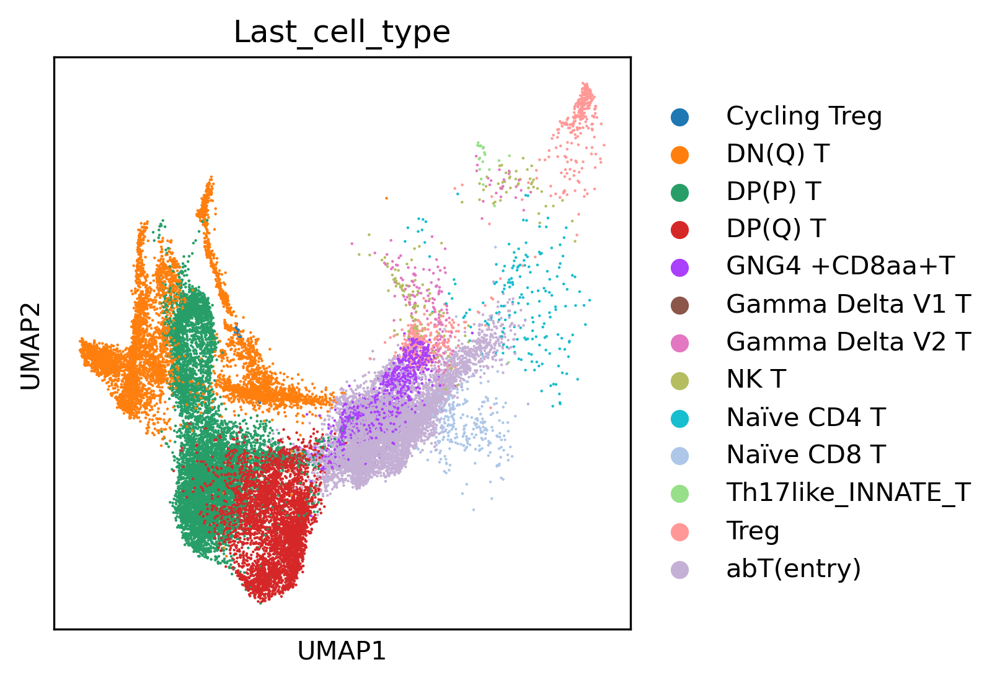

In [28]:
sc.pl.umap(thymust_cell,color=['Last_cell_type'])

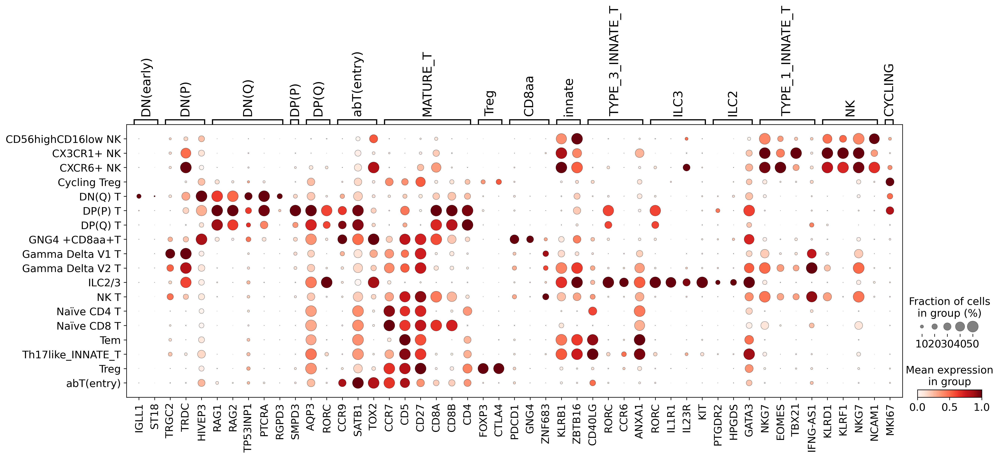

In [29]:

custom_fontsize = 16


custom_rc = {
    'font.size': custom_fontsize,
    'axes.titlesize': custom_fontsize,
    'axes.labelsize': custom_fontsize,
    'xtick.labelsize': custom_fontsize,
    'ytick.labelsize': custom_fontsize,
}


with plt.rc_context(rc=custom_rc):

    sc.pl.dotplot(TNKcombined_cells  ,Tcell_markers,'Last_cell_type',dot_max=0.5,standard_scale='var')

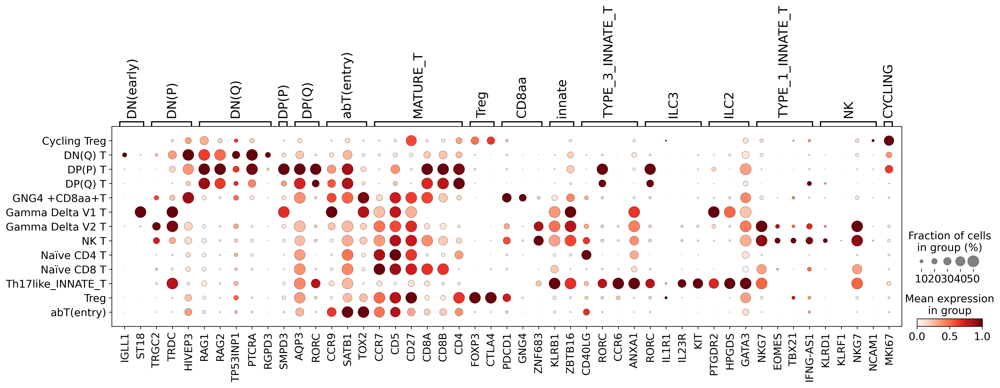

In [30]:

custom_fontsize = 16


custom_rc = {
    'font.size': custom_fontsize,
    'axes.titlesize': custom_fontsize,
    'axes.labelsize': custom_fontsize,
    'xtick.labelsize': custom_fontsize,
    'ytick.labelsize': custom_fontsize,
}


with plt.rc_context(rc=custom_rc):

    sc.pl.dotplot(thymust_cell  ,Tcell_markers,'Last_cell_type',dot_max=0.5,standard_scale='var')

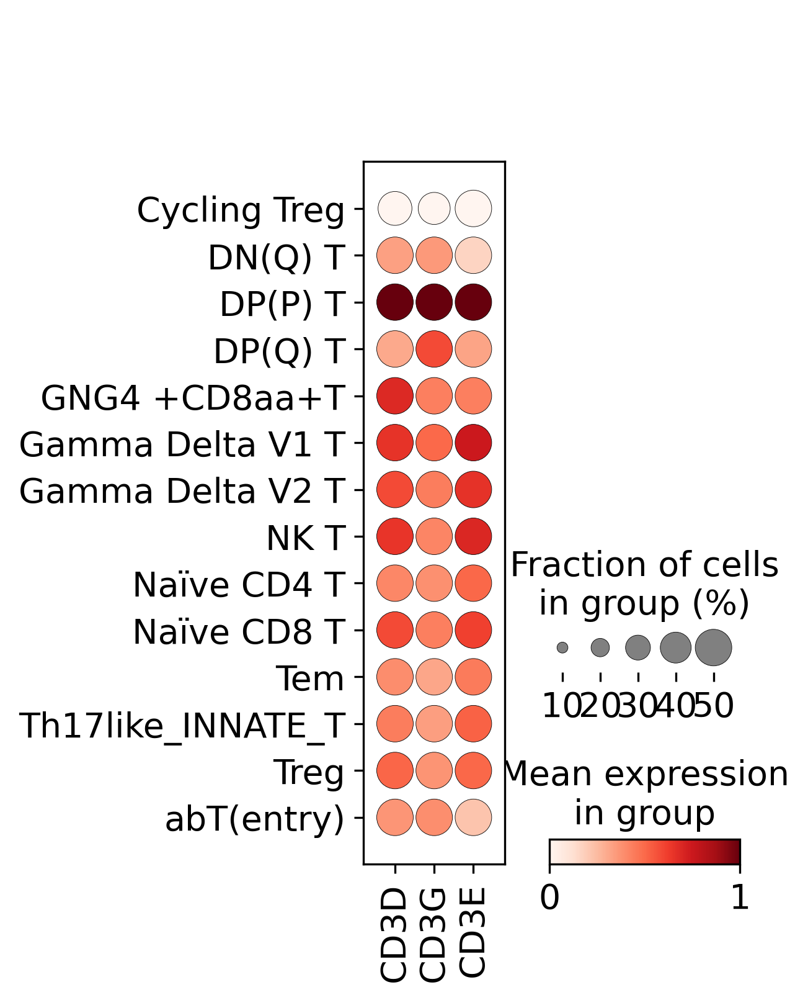

In [31]:

custom_fontsize = 16


custom_rc = {
    'font.size': custom_fontsize,
    'axes.titlesize': custom_fontsize,
    'axes.labelsize': custom_fontsize,
    'xtick.labelsize': custom_fontsize,
    'ytick.labelsize': custom_fontsize,
}


with plt.rc_context(rc=custom_rc):

    sc.pl.dotplot(t_cells ,['CD3D','CD3G','CD3E'],'Last_cell_type',dot_max=0.5,standard_scale='var')

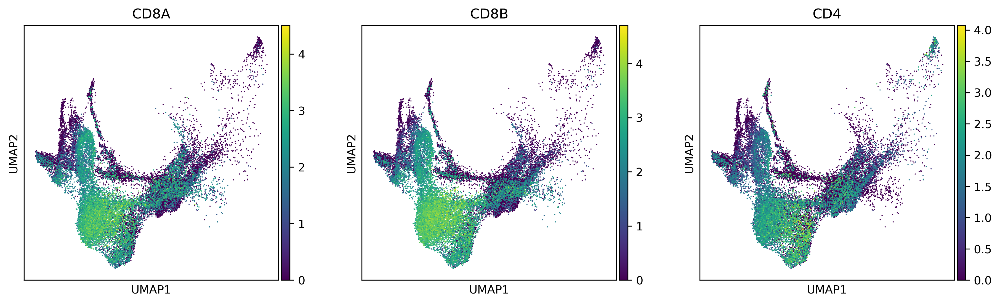

In [32]:
sc.pl.umap(thymust_cell,color=['CD8A','CD8B','CD4'])

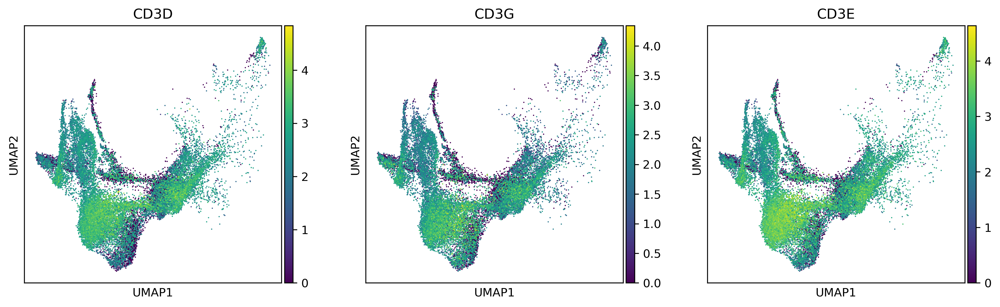

In [33]:
sc.pl.umap(thymust_cell,color=['CD3D','CD3G','CD3E'])

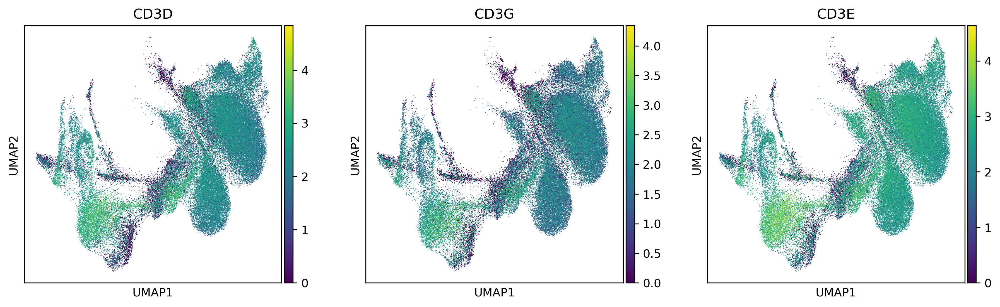

In [34]:
sc.pl.umap(t_cells,color=['CD3D','CD3G','CD3E'])

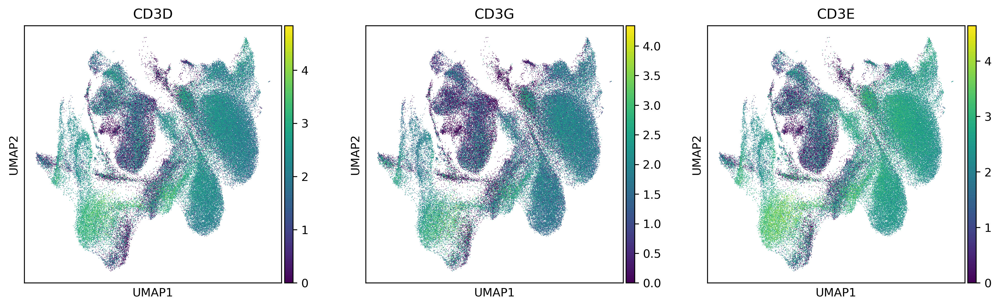

In [35]:
sc.pl.umap(TNKcombined_cells,color=['CD3D','CD3G','CD3E'])

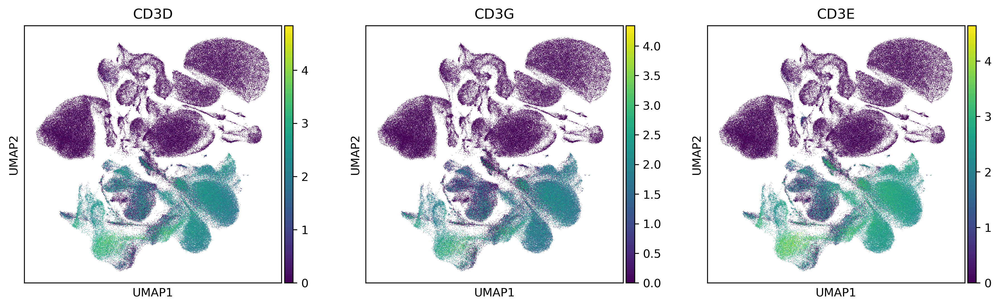

In [36]:
sc.pl.umap(adata1,color=['CD3D','CD3G','CD3E'])

In [37]:

b_cells = adata1[adata1.obs["Last_cell_type"].str.contains(" B|-B", case=True), :]


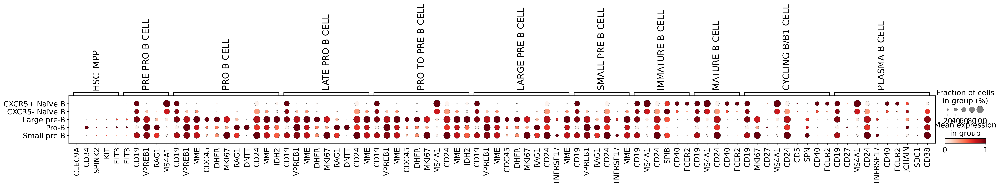

In [38]:

custom_fontsize = 18


custom_rc = {
    'font.size': custom_fontsize,
    'axes.titlesize': custom_fontsize,
    'axes.labelsize': custom_fontsize,
    'xtick.labelsize': custom_fontsize,
    'ytick.labelsize': custom_fontsize,
}


with plt.rc_context(rc=custom_rc):
    sc.pl.dotplot(b_cells   ,Bcell_type_genes,'Last_cell_type',swap_axes=False,standard_scale='var')

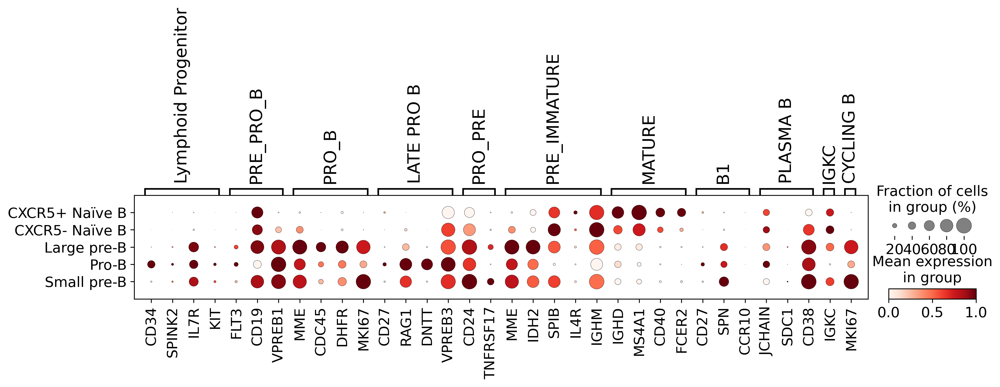

In [39]:

custom_fontsize = 16


custom_rc = {
    'font.size': custom_fontsize,
    'axes.titlesize': custom_fontsize,
    'axes.labelsize': custom_fontsize,
    'xtick.labelsize': custom_fontsize,
    'ytick.labelsize': custom_fontsize,
}


with plt.rc_context(rc=custom_rc):
    sc.pl.dotplot(b_cells   ,Bcell_markers,'Last_cell_type',swap_axes=False,standard_scale='var')

/data1/maolp/mamba/envs/Pyscan/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


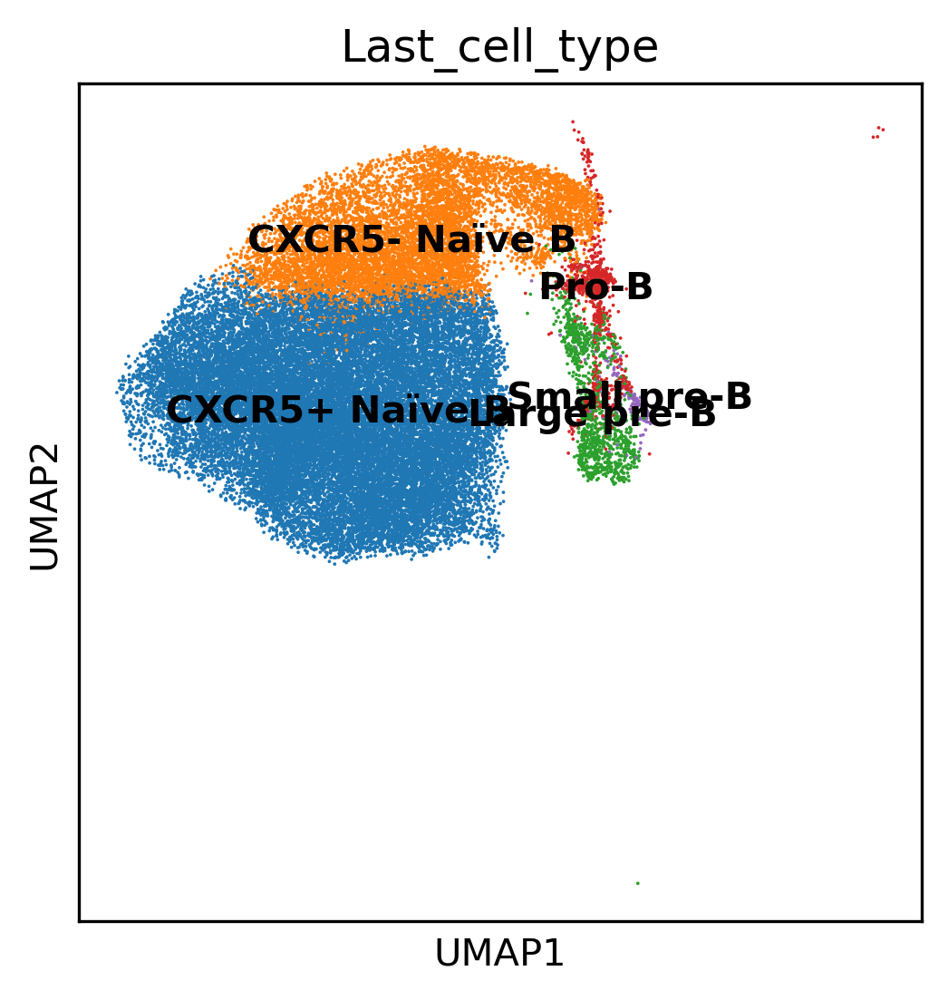

In [40]:
sc.pl.umap(b_cells,color=['Last_cell_type'],legend_loc='on data')

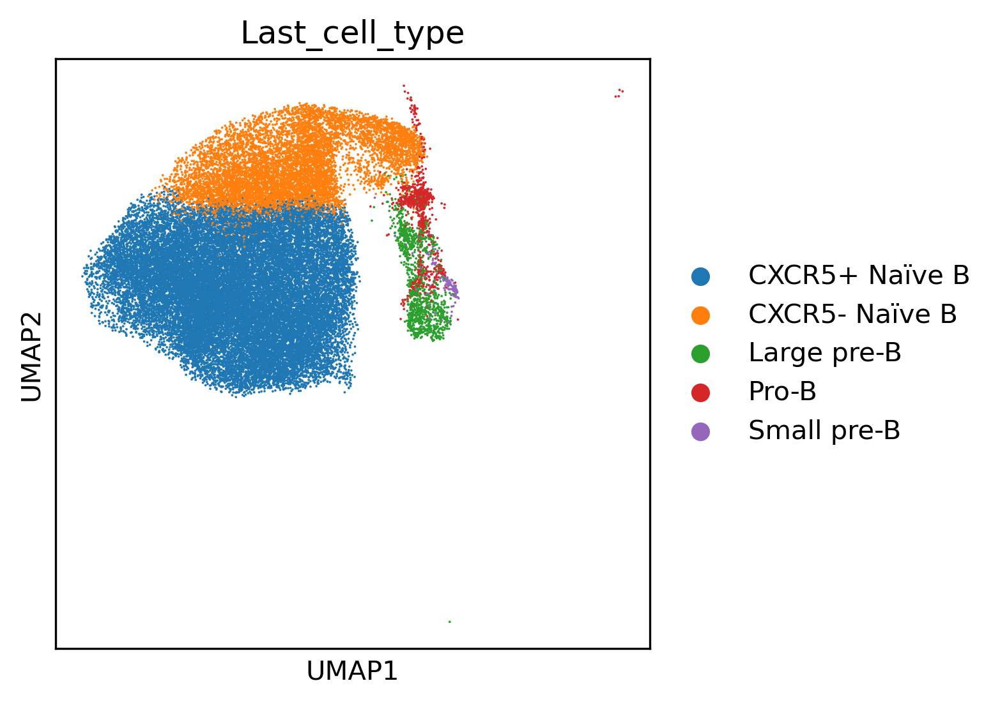

In [41]:
sc.pl.umap(b_cells,color=['Last_cell_type'])

In [42]:

Monocells= adata1[adata1.obs["Last_cell_type"].str.contains("Mono", case=True), :]
DCcells=adata1[adata1.obs["Last_cell_type"].str.contains("DC", case=True), :]
Mastcells=adata1[adata1.obs["Last_cell_type"].str.contains("Mast", case=True), :]
Myeloid=adata1[adata1.obs["Last_cell_type"].str.contains("Myeloid", case=True), :]
MAC=adata1[adata1.obs["Last_cell_type"].str.contains("Mac", case=True), :]
MonoDC_cells = Monocells.concatenate(DCcells)
MonoDCmast_cells=MonoDC_cells.concatenate(Mastcells)
MonoDCmast_cells2=MonoDCmast_cells.concatenate(Myeloid)
MonoDCmast_cells3=MonoDCmast_cells2.concatenate(MAC)

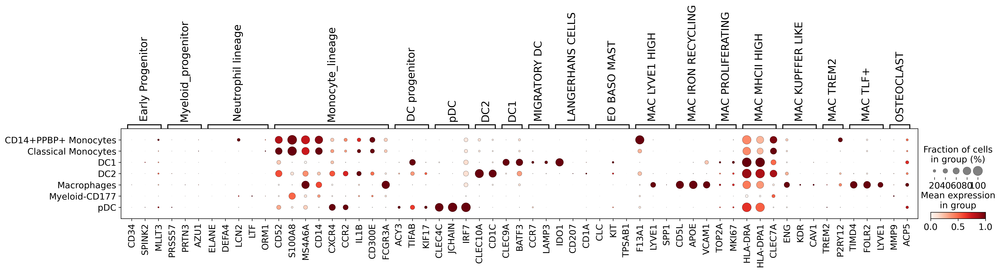

In [43]:

custom_fontsize = 16


custom_rc = {
    'font.size': custom_fontsize,
    'axes.titlesize': custom_fontsize,
    'axes.labelsize': custom_fontsize,
    'xtick.labelsize': custom_fontsize,
    'ytick.labelsize': custom_fontsize,
}


with plt.rc_context(rc=custom_rc):
    sc.pl.dotplot(MonoDCmast_cells3  ,EMpgene,'Last_cell_type',standard_scale='var')

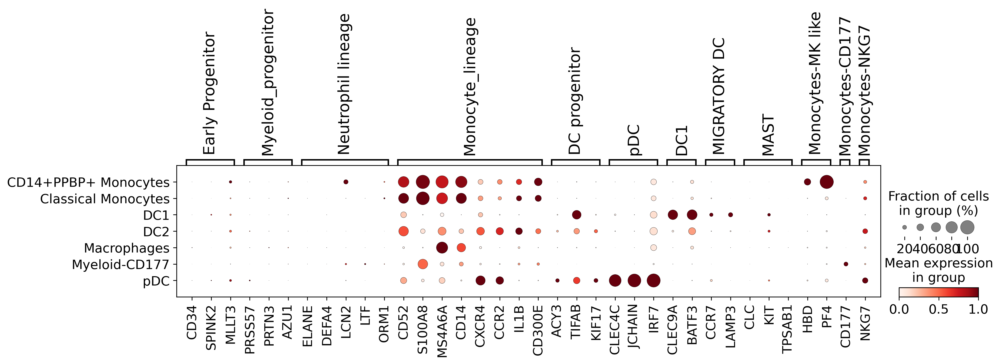

In [44]:

custom_fontsize = 16


custom_rc = {
    'font.size': custom_fontsize,
    'axes.titlesize': custom_fontsize,
    'axes.labelsize': custom_fontsize,
    'xtick.labelsize': custom_fontsize,
    'ytick.labelsize': custom_fontsize,
}


with plt.rc_context(rc=custom_rc):
    sc.pl.dotplot(MonoDCmast_cells3  ,Myeloid_markers,'Last_cell_type',standard_scale='var')

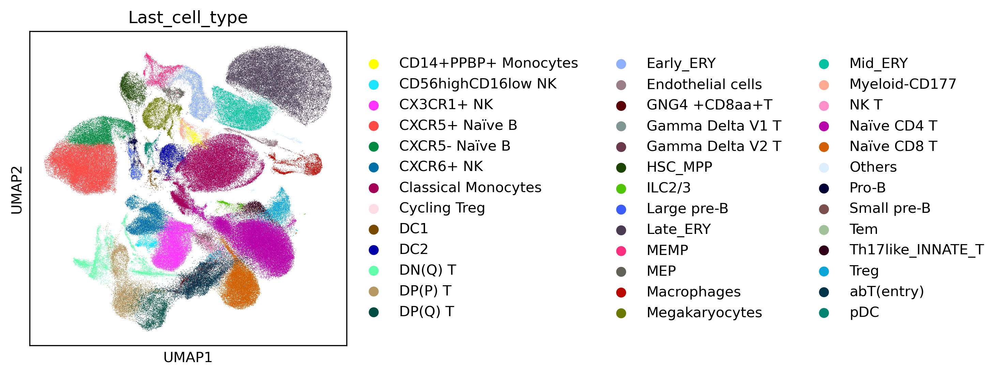

In [45]:
sc.pl.umap(adata1, color='Last_cell_type')

In [46]:
# sc.pl.umap(Monocell, color='majority_voting')

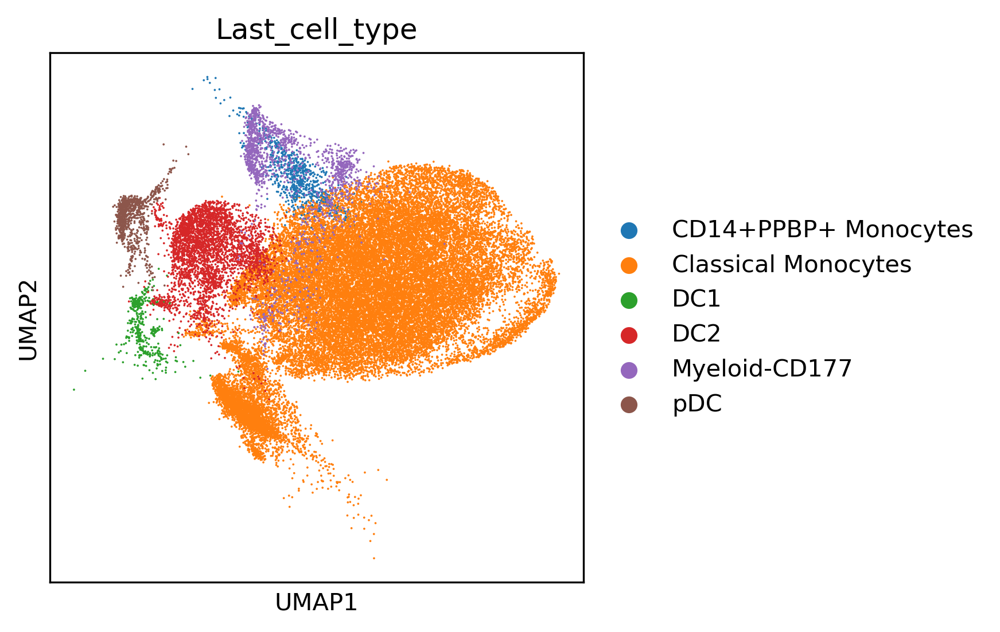

In [47]:
sc.pl.umap(MonoDCmast_cells2 ,color=['Last_cell_type'])

In [48]:
### ER
MEGA_ER_cells= adata1[adata1.obs["Last_cell_type"].str.contains("ER", case=True), :]
MKcells=adata1[adata1.obs["Last_cell_type"].str.contains("_MK", case=True), :]
placell=adata1[adata1.obs["Last_cell_type"].str.contains("Plat", case=True), :]

MKE_cells = MEGA_ER_cells.concatenate(MKcells)
MKPE_cells=MKE_cells.concatenate(placell)

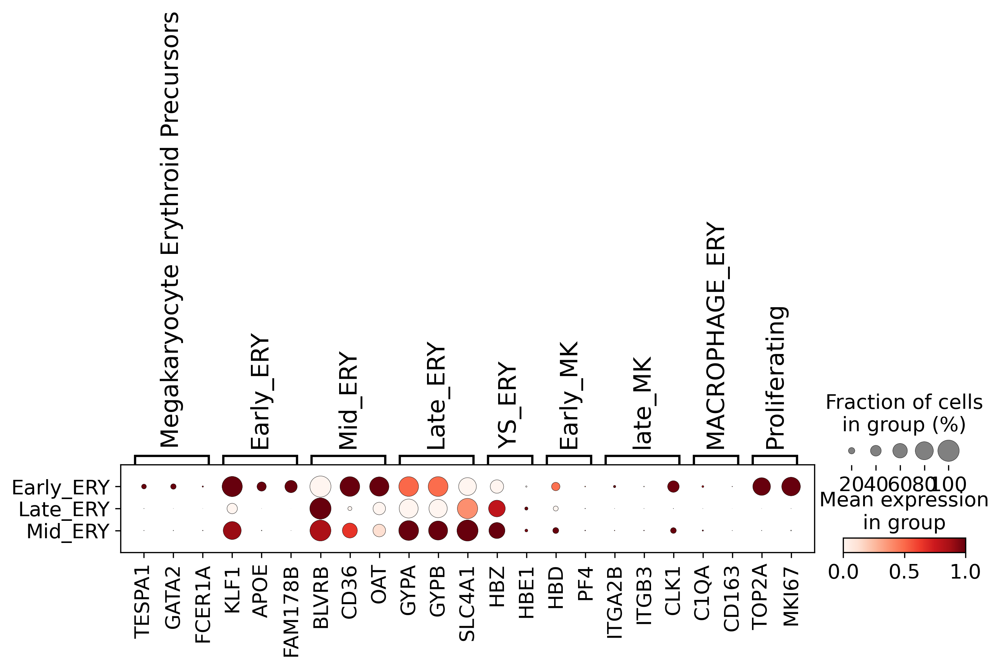

In [49]:

custom_fontsize = 16


custom_rc = {
    'font.size': custom_fontsize,
    'axes.titlesize': custom_fontsize,
    'axes.labelsize': custom_fontsize,
    'xtick.labelsize': custom_fontsize,
    'ytick.labelsize': custom_fontsize,
}


with plt.rc_context(rc=custom_rc):
    sc.pl.dotplot(MKPE_cells ,MEGA_ER_markers,'Last_cell_type',standard_scale='var')

In [50]:
precursor_cells = ['HSC_MPP', 'MEP', 'MEMP','Cycling MEMP','MLP']
pre_cells = adata1[adata1.obs['Last_cell_type'].isin(precursor_cells)].copy()


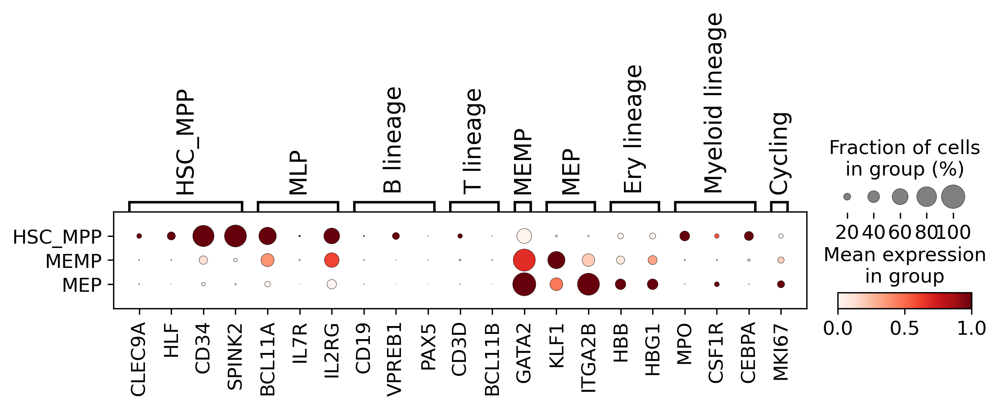

In [51]:

custom_fontsize = 14


custom_rc = {
    'font.size': custom_fontsize,
    'axes.titlesize': custom_fontsize,
    'axes.labelsize': custom_fontsize,
    'xtick.labelsize': custom_fontsize,
    'ytick.labelsize': custom_fontsize,
}

with plt.rc_context(rc=custom_rc):
    sc.pl.dotplot(pre_cells,progenitor_gene,'Last_cell_type',standard_scale='var')

In [52]:
pre_cells

AnnData object with n_obs × n_vars = 6909 × 31424
    obs: 'Name', 'doublet_scores', 'predicted_doublets', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Cellname', 'AdjustedID', 'New_Body', 'Week', 'TCRBCRlabel', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Last_cell_type', 'Cell_lineage', 'Last_cell_type2', 'Last_cell_type_num', 'Last_cell_type_num2'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'AdjustedID_colors', 'Cell_lineage_colors', 'Last_cell_type_num_colors', 'New_Body_colors', 'TCRBCRlabel_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'majority_voting_colors', 'neighbors', 'pca', 'umap', 'Last_cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

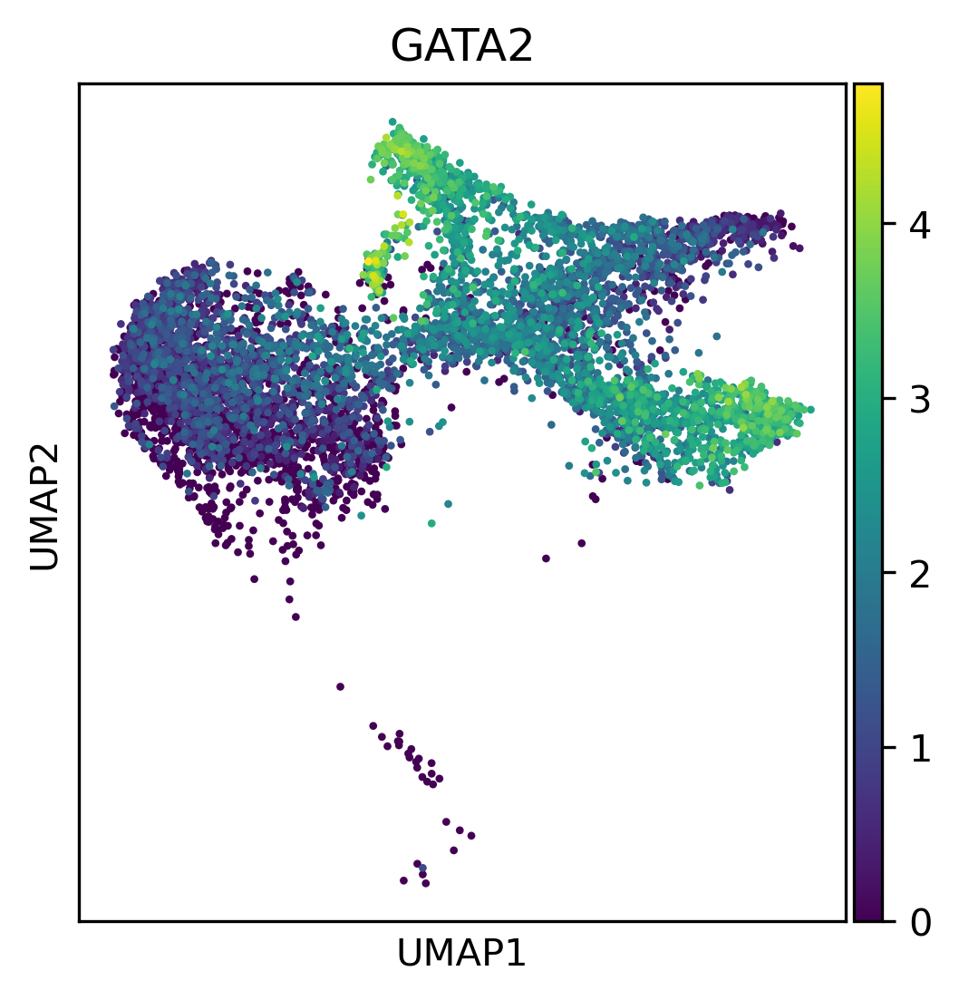

In [53]:
sc.pl.umap(pre_cells ,color=['GATA2'])

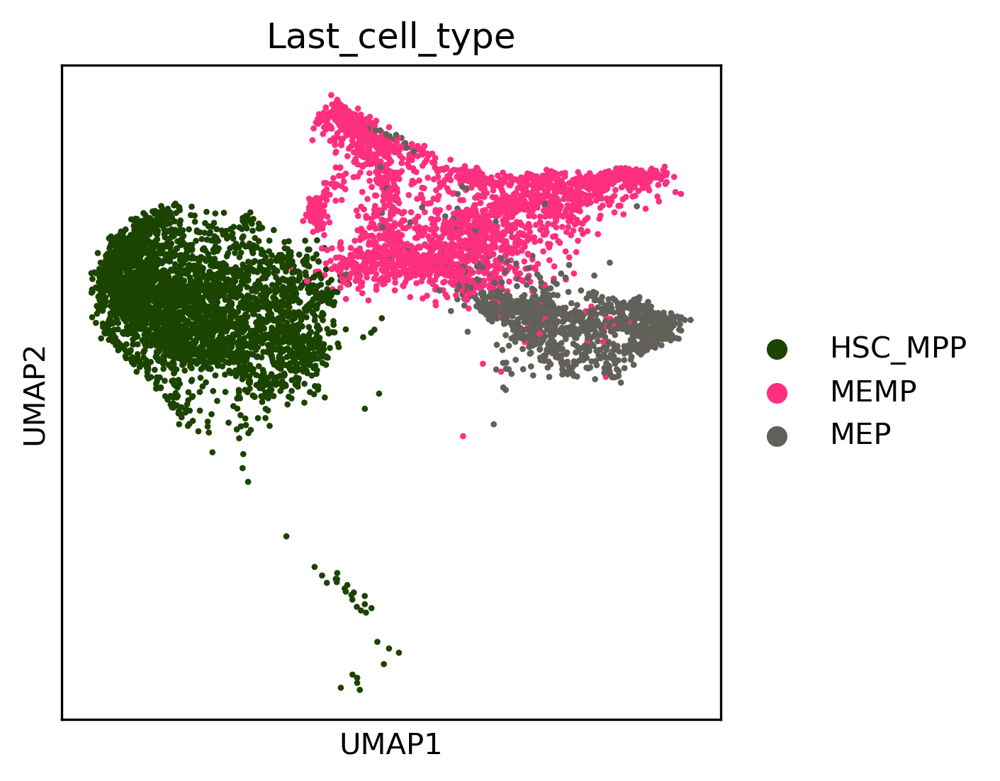

In [54]:
sc.pl.umap(pre_cells ,color=['Last_cell_type'])

In [55]:
adata1.obs["Last_cell_type"]=adata1.obs["Last_cell_type"].astype('str')

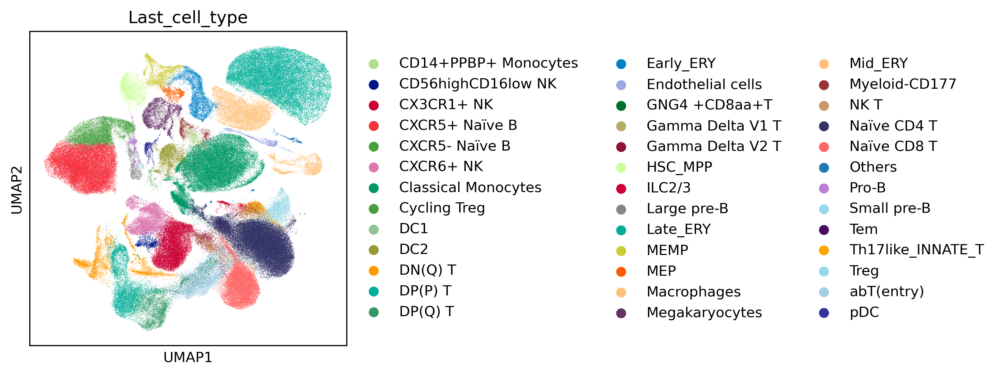

In [56]:
sc.pl.umap(adata1 ,color=['Last_cell_type'],palette=create_palette(adata1.obs["Last_cell_type"].unique(),colorname2))

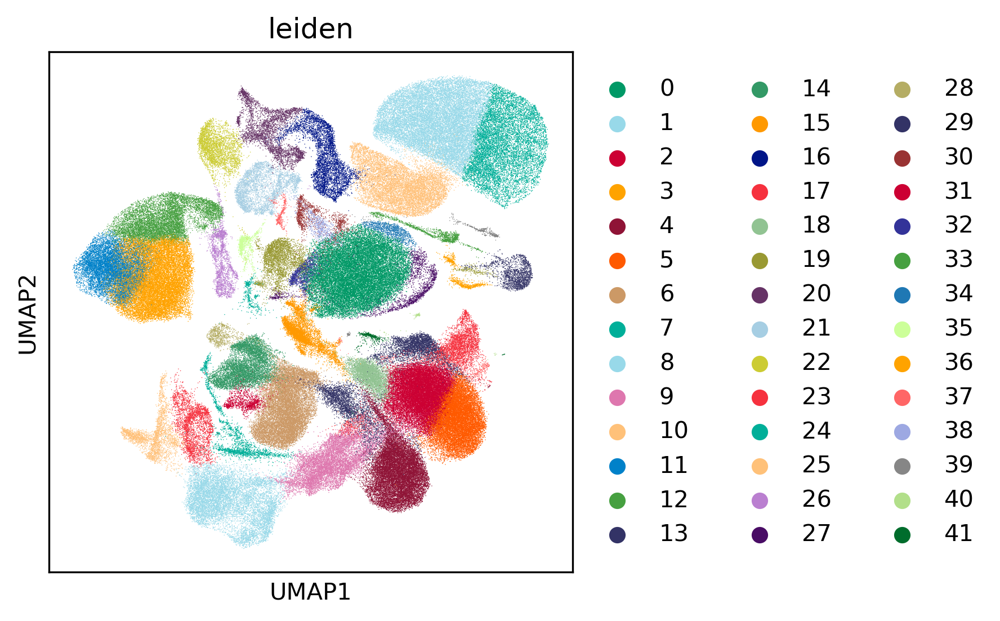

In [57]:
sc.pl.umap(adata1 ,color=['leiden'],palette=create_palette(adata1.obs["leiden"].unique(),colorname2))